<a href="https://colab.research.google.com/github/dianakhp26/Spy-Camera-Object-Detection/blob/main/Faster_R_CNN_on_Detectron_2_Molka_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Spycam detection using Faster R-CNN Detectron2 pre-trained model

The following report presents an implementation of the Faster R-CNN Detectron2 pre-trained model making use of a custom dataset for hidden camera detection.

### **Steps Covered in this Report**

To train the Faster R-CNN model the following steps need to be carried out:

* Install dependencies
* Load custom dataset from Roboflow
* Model training
* Evaluate Trainning Results
* Inference on test images

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cd /content/gdrive/MyDrive

/content/gdrive/MyDrive


In [ ]:
import os
if not os.path.isdir("molka2.3"):
  os.makedirs("molka2.3")

In [ ]:
%cd molka2.3

/content/gdrive/MyDrive/molka2.3


#Install Dependencies

The necessary dependencies for running a model that uses Detectron2 (PyTorch, torchvision, Cython, PyYAML)

In [ ]:
# Install dependencies
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
ERROR: Could not find a version that satisfies the requirement torch==1.5 (from versions: 1.11.0, 1.12.0, 1.12.1, 1.13.0, 1.13.1, 2.0.0, 2.0.1, 2.1.0, 2.1.1, 2.1.2, 2.2.0, 2.2.1, 2.2.2, 2.3.0, 2.3.1, 2.4.0)
ERROR: No matching distribution found for torch==1.5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 18.9 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-g8wo5uu5
  Running com

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 15756, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 15756 (delta 1), reused 6 (delta 1), pack-reused 15743 (from 1)
Receiving objects: 100% (15756/15756), 6.32 MiB | 12.55 MiB/s, done.
Resolving deltas: 100% (11495/11495), done.
Updating files: 100% (827/827), done.
Obtaining file:///content/gdrive/MyDrive/molka2.3/detectron2_repo
  Preparing metadata (setup.py) ... done
  Using cached pycocotools-2.0.8-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (1.1 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 11.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB

In [ ]:
# Detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# Common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Download Correctly Formatted Custom Data

The dataset used for this prototype was compiled manually making use of various online resources and directly taking photos of spy cameras, labeled on the online platform 'Roboflow', it contains 1300 images of these devices.

In [ ]:
%cd /content/gdrive/MyDrive/molka2.3
!curl -L https://app.roboflow.com/ds/RjfD3JgODj?key=IrdKPHc3Yl > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content/gdrive/MyDrive/molka2.3
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2034      0 --:--:-- --:--:-- --:--:--  2033
100 55.3M  100 55.3M    0     0  10.0M      0  0:00:05  0:00:05 --:--:-- 13.2M
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
   creating: test/
  inflating: test/_annotations.coco.json  
 extracting: test/spycam-101-_jpg.rf.1bbfb71f9fa0e1a3cb6c7111fc2b9584.jpg  
 extracting: test/spycam-197-_jpg.rf.f1c20132a0d87a4a35afe93327d3c35f.jpg  
 extracting: test/spycam-233-_jpg.rf.f32bb124e8b74abfdd420f4a58e9de04.jpg  
 extracting: test/spycam-238-_jpg.rf.8de6030240ef423508fdad2ea06cde9a.jpg  
 extracting: test/spycam-249-_jpg.rf.46bb4e1bbf7eea238adee7de3ef05e6f.jpg  
 extracting: test/spycam-252-_jpg.rf.ff5fab06ac61fcd6aa6163fc55e579ec.jpg  
 extracting: test/spycam-259-_jpg.

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/gdrive/My Drive/molka2.3/train/_annotations.coco.json", "/content/gdrive/My Drive/molka2.3/train")
register_coco_instances("my_dataset_val", {}, "/content/gdrive/My Drive/molka2.3/valid/_annotations.coco.json", "/content/gdrive/My Drive/molka2.3/valid")
register_coco_instances("my_dataset_test", {}, "/content/gdrive/My Drive/molka2.3/test/_annotations.coco.json", "/content/gdrive/My Drive/molka2.3/test")

WARNING [08/13 19:22:46 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/13 19:22:46 d2.data.datasets.coco]: Loaded 1200 images in COCO format from /content/gdrive/My Drive/molka2.3/train/_annotations.coco.json


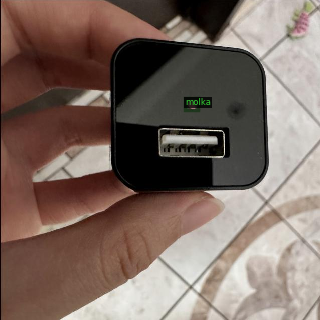

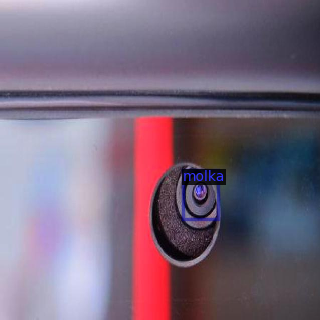

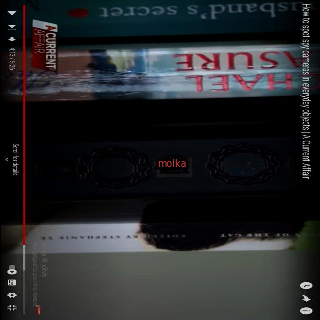

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Custom Training

The training will be carried out for 3000 iterations.

In [ ]:
#Trainer Module to use the COCO validation evaluation during training

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 3000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05


cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/13 19:23:08 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_68b088.pkl: 421MB [00:01, 243MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[08/13 19:23:11 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[08/13 19:24:10 d2.utils.events]:  eta: 2:17:50  iter: 19  total_loss: 1.426  loss_cls: 0.9603  loss_box_reg: 0.1318  loss_rpn_cls: 0.3107  loss_rpn_loc: 0.05458    time: 2.6999  last_time: 2.6766  data_time: 0.0491  last_data_time: 0.0124   lr: 1.931e-06  max_mem: 6900M
[08/13 19:25:10 d2.utils.events]:  eta: 2:17:50  iter: 39  total_loss: 1.478  loss_cls: 0.9178  loss_box_reg: 0.08451  loss_rpn_cls: 0.3101  loss_rpn_loc: 0.04845    time: 2.7712  last_time: 2.6129  data_time: 0.0217  last_data_time: 0.0112   lr: 2.911e-06  max_mem: 6900M
[08/13 19:26:08 d2.utils.events]:  eta: 2:18:40  iter: 59  total_loss: 1.395  loss_cls: 0.8603  loss_box_reg: 0.1591  loss_rpn_cls: 0.1929  loss_rpn_loc: 0.03799    time: 2.8228  last_time: 3.0751  data_time: 0.0189  last_data_time: 0.0113   lr: 3.891e-06  max_mem: 6900M
[08/13 19:27:06 d2.utils.events]:  eta: 2:17:35  iter: 79  total_loss: 1.322  loss_cls: 0.7813  loss_box_reg: 0.1578  loss_rpn_cls: 0.3671  loss_rpn_loc: 0.04205    time: 2.8397  last

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 19:47:42 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0046 s/iter. Inference: 0.1877 s/iter. Eval: 0.0005 s/iter. Total: 0.1928 s/iter. ETA=0:00:07
[08/13 19:47:47 d2.evaluation.evaluator]: Inference done 38/50. Dataloading: 0.0036 s/iter. Inference: 0.1867 s/iter. Eval: 0.0004 s/iter. Total: 0.1910 s/iter. ETA=0:00:02
[08/13 19:47:49 d2.evaluation.evaluator]: Total inference time: 0:00:08.643094 (0.192069 s / iter per device, on 1 devices)
[08/13 19:47:49 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.186375 s / iter per device, on 1 devices)
[08/13 19:47:49 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 19:47:49 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[08/13 19:47:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[08/13 19:47:50 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 20:11:59 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0015 s/iter. Inference: 0.1852 s/iter. Eval: 0.0004 s/iter. Total: 0.1871 s/iter. ETA=0:00:07
[08/13 20:12:04 d2.evaluation.evaluator]: Inference done 37/50. Dataloading: 0.0068 s/iter. Inference: 0.1857 s/iter. Eval: 0.0004 s/iter. Total: 0.1931 s/iter. ETA=0:00:02
[08/13 20:12:07 d2.evaluation.evaluator]: Total inference time: 0:00:08.803455 (0.195632 s / iter per device, on 1 devices)
[08/13 20:12:07 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.185929 s / iter per device, on 1 devices)
[08/13 20:12:07 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 20:12:07 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[08/13 20:12:07 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[08/13 20:12:07 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 20:36:20 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0013 s/iter. Inference: 0.1865 s/iter. Eval: 0.0004 s/iter. Total: 0.1881 s/iter. ETA=0:00:07
[08/13 20:36:25 d2.evaluation.evaluator]: Inference done 38/50. Dataloading: 0.0018 s/iter. Inference: 0.1858 s/iter. Eval: 0.0003 s/iter. Total: 0.1880 s/iter. ETA=0:00:02
[08/13 20:36:27 d2.evaluation.evaluator]: Total inference time: 0:00:08.556396 (0.190142 s / iter per device, on 1 devices)
[08/13 20:36:27 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.185841 s / iter per device, on 1 devices)
[08/13 20:36:27 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 20:36:27 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[08/13 20:36:27 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[08/13 20:36:27 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 21:00:50 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0013 s/iter. Inference: 0.1853 s/iter. Eval: 0.0003 s/iter. Total: 0.1870 s/iter. ETA=0:00:07
[08/13 21:00:56 d2.evaluation.evaluator]: Inference done 38/50. Dataloading: 0.0022 s/iter. Inference: 0.1866 s/iter. Eval: 0.0004 s/iter. Total: 0.1894 s/iter. ETA=0:00:02
[08/13 21:00:58 d2.evaluation.evaluator]: Total inference time: 0:00:08.690166 (0.193115 s / iter per device, on 1 devices)
[08/13 21:00:58 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.187018 s / iter per device, on 1 devices)
[08/13 21:00:58 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 21:00:58 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[08/13 21:00:58 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[08/13 21:00:58 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 21:25:18 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0018 s/iter. Inference: 0.1853 s/iter. Eval: 0.0003 s/iter. Total: 0.1875 s/iter. ETA=0:00:07
[08/13 21:25:23 d2.evaluation.evaluator]: Inference done 38/50. Dataloading: 0.0026 s/iter. Inference: 0.1861 s/iter. Eval: 0.0004 s/iter. Total: 0.1892 s/iter. ETA=0:00:02
[08/13 21:25:25 d2.evaluation.evaluator]: Total inference time: 0:00:08.683953 (0.192977 s / iter per device, on 1 devices)
[08/13 21:25:25 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.186531 s / iter per device, on 1 devices)
[08/13 21:25:25 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 21:25:25 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[08/13 21:25:25 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[08/13 21:25:25 d2.evaluation.

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 21:49:43 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0013 s/iter. Inference: 0.1852 s/iter. Eval: 0.0004 s/iter. Total: 0.1869 s/iter. ETA=0:00:07
[08/13 21:49:48 d2.evaluation.evaluator]: Inference done 38/50. Dataloading: 0.0017 s/iter. Inference: 0.1848 s/iter. Eval: 0.0003 s/iter. Total: 0.1871 s/iter. ETA=0:00:02
[08/13 21:49:51 d2.evaluation.evaluator]: Total inference time: 0:00:08.501102 (0.188913 s / iter per device, on 1 devices)
[08/13 21:49:51 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:08 (0.184874 s / iter per device, on 1 devices)
[08/13 21:49:51 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 21:49:51 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[08/13 21:49:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[08/13 21:49:51 d2.evaluation.

# Trainning Results

Graphs to evaluate the performance of the model

In [ ]:
# Training curves in tensorboard
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Inference on test set

Using the trained model results to perform inference on the test set and evaluate its execution.

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[08/13 22:41:14 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [08/13 22:41:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [08/13 22:41:16 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/13 22:41:16 d2.data.datasets.coco]: Loaded 50 images in COCO format from /content/gdrive/My Drive/molka2.3/test/_annotations.coco.json
[08/13 22:41:16 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   molka    | 0            |   molka    | 50           |
|            |              |            |              |
|   total    | 50           |            |              |
[08/13 22:41:16 d2.data.dataset_mapper]: [DatasetMapper] Augme

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/13 22:41:19 d2.evaluation.evaluator]: Inference done 11/50. Dataloading: 0.0027 s/iter. Inference: 0.1752 s/iter. Eval: 0.0004 s/iter. Total: 0.1783 s/iter. ETA=0:00:06
[08/13 22:41:24 d2.evaluation.evaluator]: Inference done 39/50. Dataloading: 0.0038 s/iter. Inference: 0.1751 s/iter. Eval: 0.0004 s/iter. Total: 0.1795 s/iter. ETA=0:00:01
[08/13 22:41:26 d2.evaluation.evaluator]: Total inference time: 0:00:08.159987 (0.181333 s / iter per device, on 1 devices)
[08/13 22:41:26 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:07 (0.174739 s / iter per device, on 1 devices)
[08/13 22:41:26 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/13 22:41:26 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[08/13 22:41:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[08/13 22:41:26 d2.evaluation.f

OrderedDict([('bbox',
              {'AP': 15.310942949970844,
               'AP50': 30.967588913929134,
               'AP75': 15.03466402941358,
               'APs': 11.711116447281842,
               'APm': 26.215199791900883,
               'APl': 22.159358793022164,
               'AP-molka': 15.310942949970844})])

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[08/13 22:41:42 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


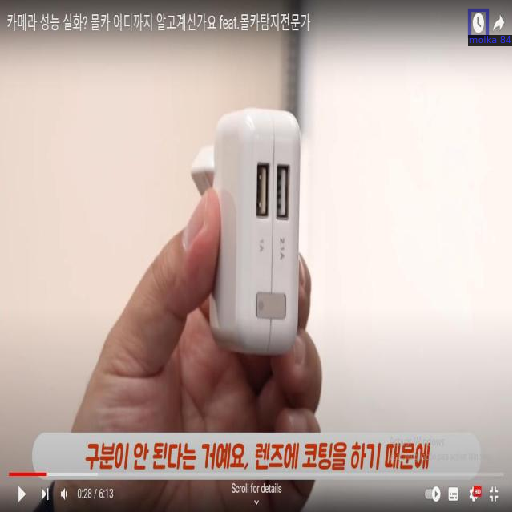

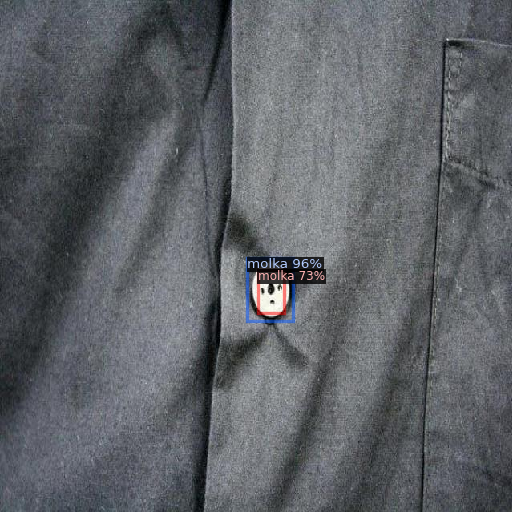

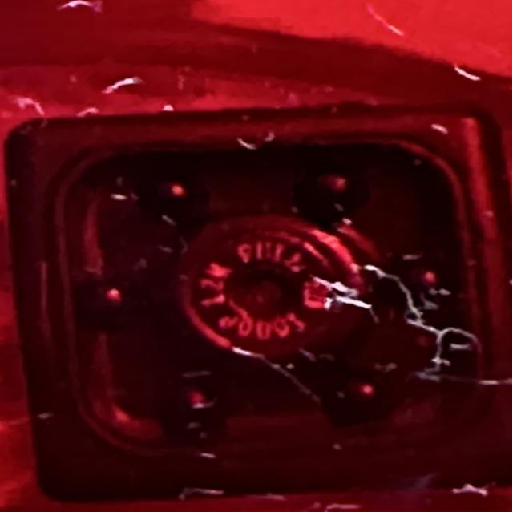

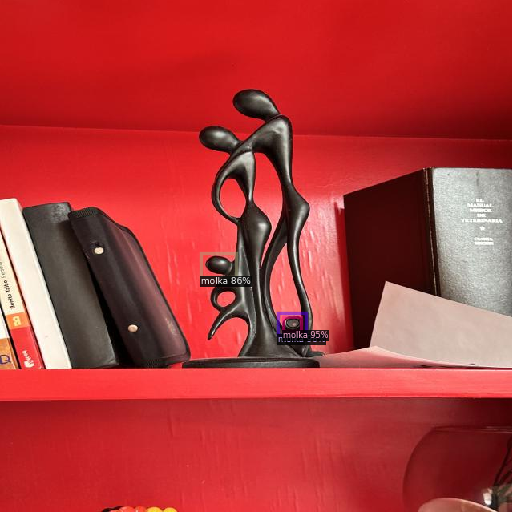

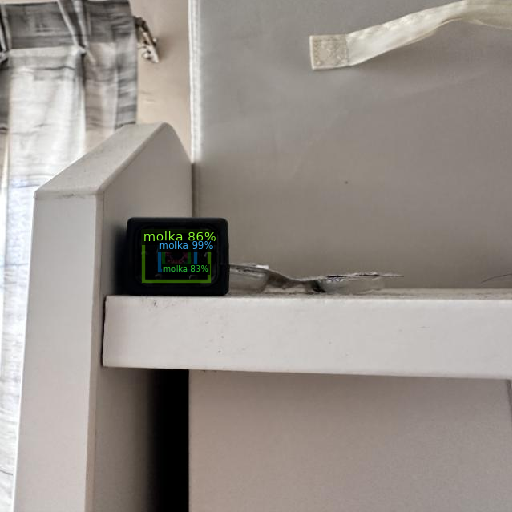

...

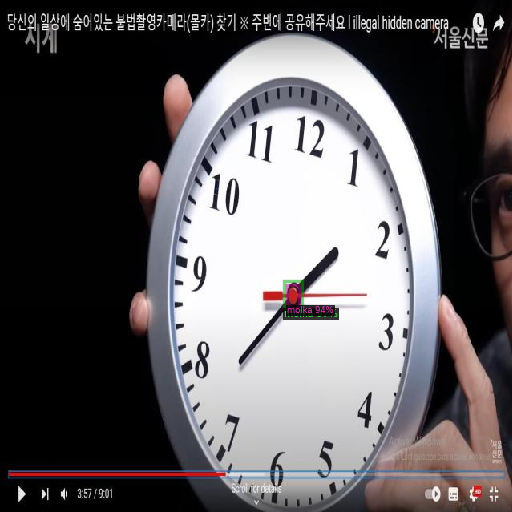

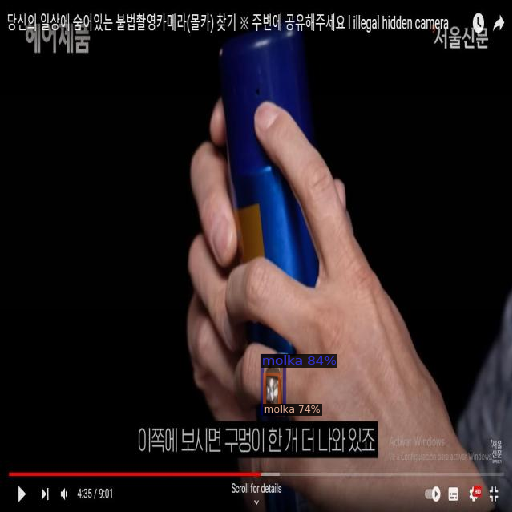

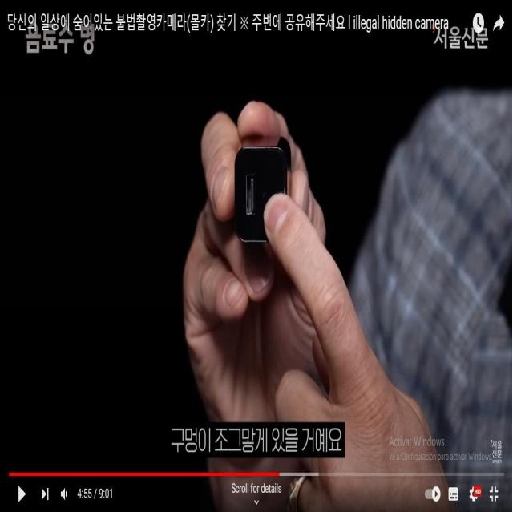

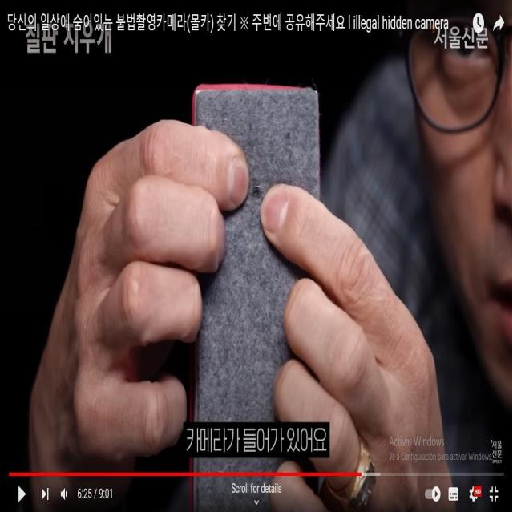

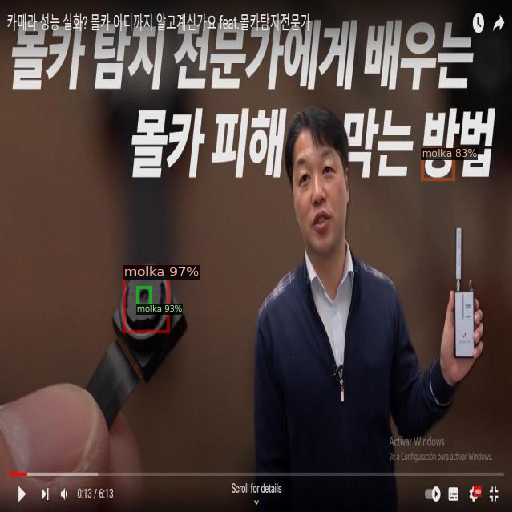

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/gdrive/My Drive/molka2.3/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])